In [1]:
import pclpy
from pclpy import pcl
# read a las file
point_cloud = pclpy.read("../lidar/data/4810E_54560N.las", "PointXYZ")
output = "../lidar/data/4810E_54560N.pcd"
writer = pcl.io.PCDWriter()
writer.writeBinary(output, point_cloud)
# compute mls
# output = point_cloud.moving_least_squares(search_radius=0.05, compute_normals=True, num_threads=8)

0

In [72]:
from pyproj import Proj
UTM_10_PROJ = Proj("+proj=utm +zone=10N, +north +ellps=WGS84 +datum=WGS84 +units=m +no_defs")

In [73]:
type(point_cloud.points)

pclpy.pcl.vectors.PointXYZ

In [74]:
import plotly.express as px

In [75]:
# about 20,000,000 points
import numpy as np
points = np.zeros((120000, 3))
for i in range(points.shape[0]):
#     x_y = UTM_10_PROJ(point_cloud.points[i].x, point_cloud.points[i].y, inverse=True)
#     if point_cloud.points[i].z < 74 or point_cloud.points[i].z > 82:
    if point_cloud.points[i].z < 40:
        continue
    points[i] = [point_cloud.points[i].x, point_cloud.points[i].y, point_cloud.points[i].z]
#     print(point.x, " ", point.y)
#     print(UTM_10_PROJ(point.x, point.y, inverse=True))

filter_points = points[points != [0, 0, 0]]
points = filter_points.reshape((int(filter_points.shape[0]/3), 3))
pc_subset = pcl.PointCloud.PointXYZ(points)

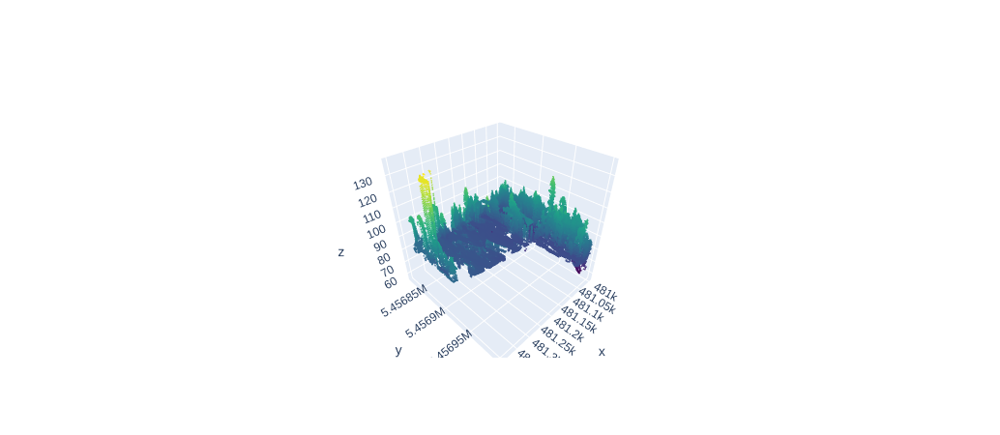

In [76]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=[go.Scatter3d(x=points[:, 0], y=points[:, 1], z=points[:, 2],
                                   mode='markers', marker=dict(
        size=1,
        color=points[:, 2],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    ))])
fig.update_yaxes(
    scaleanchor = "x",
    scaleratio = 1,
  )
fig.show()

In [77]:
# print cluters
from pyproj import Geod
geod = Geod(ellps="WGS84")
import pclpy

def return_index(cluster_index, pc, scale=True):
    total_index = len(cluster_index.indices)
    cluster_points = np.zeros((total_index, 3))
    for i in range(total_index):
        x_y = UTM_10_PROJ(pc.points[i].x, pc.points[i].y, inverse=True)
        cluster_points[i] = ([x_y[0], x_y[1], pc.points[i].z])
    if scale:
        # map x, y into meteres, same as z
        lat_min = np.amin(cluster_points[:, 1])
        lat_max = np.amax(cluster_points[:, 1])
        long_min = np.amin(cluster_points[:, 0])
        long_max = np.amax(cluster_points[:, 0])
        print(lat_min, lat_max, long_min, long_max)
        scale_x = geod.line_length([long_min, long_min],[lat_min, lat_max])
        scale_y = geod.line_length([long_min, long_max], [lat_min, lat_min])
        print(scale_x, scale_y)
        for point in cluster_points:
            point[0] = ((point[0] - long_min) / (long_max - long_min)) *  scale_y
            point[1] = ((point[1] - lat_min) / (lat_max - lat_min)) *  scale_x
    return cluster_points
    
def print_points(data):
    fig = go.Figure(data=[go.Scatter3d(x=data[:, 0], y=data[:, 1], z=data[:, 2],
                                   mode='markers', marker=dict(
        size=1,
        color=data[:, 2],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=1.0
    ))])
    fig.update_yaxes(
        scaleanchor = "x",
        scaleratio = 1,
      )
    fig.show()
from pclpy import pcl, utils
def segment(threshold, pc):
    inliers, coefficients = pclpy.fit(pc, "plane", distance=threshold)
    print(len(inliers.indices))
    print(len(pc.points))
    return inliers, coefficients


# Plane model

49.26390881088992 49.264794837900574 -123.26047826826141 -123.26007406843414
98.53936686793034 29.41944954597058


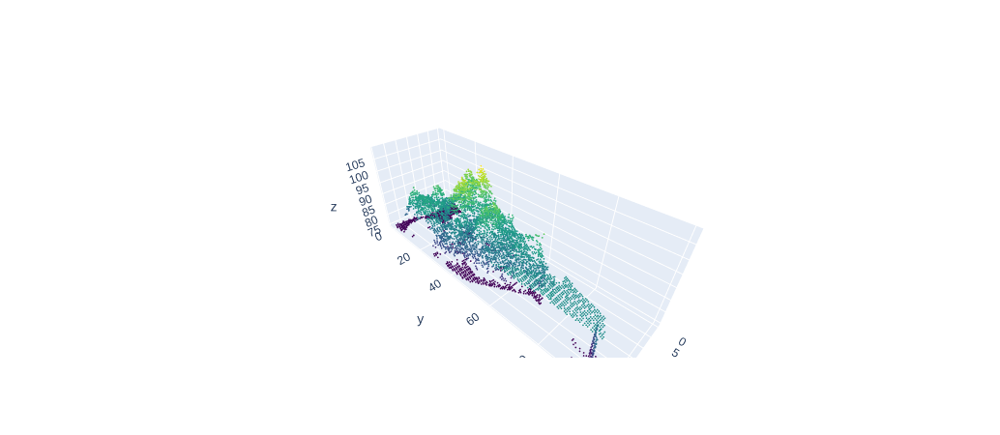

In [78]:
pc_subset_normal = pc_subset.compute_normals(radius=0.3)
# inliers, _ =  segment(2, pc_subset)
inliers = pclpy.region_growing(pc_subset, normals=pc_subset_normal, min_size=10, 
                               max_size=10000, 
                               n_neighbours=100,
                               smooth_threshold=5,
                               curvature_threshold=5,
                               residual_threshold=1,)
data = return_index(inliers[0], pc_subset)
print_points(data)

# DEM

In [139]:
import numpy as np
from pyproj import Proj
UTM_10_PROJ = Proj("+proj=utm +zone=10N, +north +ellps=WGS84 +datum=WGS84 +units=m +no_defs")
filename = '../lidar/data/UBC_481_5456_UTM10_DEM_SP000-2595_v1.xyz'
xyz = open(filename, "r")
count = 0
for line in xyz:
    count += 1
xyz.close()

xyz = open(filename,"r")
dem_points = np.ndarray((count, 3))
count = 0
for line in xyz:
    x, y, z = line.split()
#     lat, lon = UTM_10_PROJ(x, y, inverse=True)
    dem_points[count, :] = np.array([x, y, z])
    count += 1
xyz.close()
dem_points

array([[ 4.8129650e+05,  5.4560005e+06, -8.2000000e-01],
       [ 4.8129750e+05,  5.4560005e+06, -8.0000000e-01],
       [ 4.8129850e+05,  5.4560005e+06, -7.8000000e-01],
       ...,
       [ 4.8199750e+05,  5.4569995e+06,  9.0260000e+01],
       [ 4.8199850e+05,  5.4569995e+06,  9.0370000e+01],
       [ 4.8199950e+05,  5.4569995e+06,  9.0450000e+01]])

In [120]:
print(int(points[0, 0]) - 481000)
print(int(points[0, 1]) - 5456000)
sorted_dem_points[77+ 830, :]

77
830


array([4.8100150e+05, 5.4568405e+06, 7.3480000e+01])

In [204]:
# sorted_dem_points = np.sort(dem_points, 1)
# sorted_dem_points = np.vstack((sorted_dem_points[:, 1],sorted_dem_points[:, 2], sorted_dem_points[:, 0])).T
# sorted_dem_points 
sorted_dem_points = np.sort(dem_points.view('f8,f8,f8'),kind='quicksort', order=['f0'], axis=0).view(np.float)

In [219]:
# np.searchsorted(sorted_dem_points, [points[0, 0], points[0, 1]])
np.where(sorted_dem_points[:, 0:2] == [points[0, 0], points[0, 1]])
# sorted_dem_points[:, 0:2]
int_points = np.array(points, dtype=int)
test = sorted_dem_points[np.intersect1d(np.where(sorted_dem_points == int_points[0, 0] + 0.5), np.where(sorted_dem_points ==  int_points[0, 1] + 0.5))]
print(test)
print(points[0])

[[4.8107750e+05 5.4568305e+06 7.5510000e+01]]
[4.81077781e+05 5.45683050e+06 7.55199966e+01]


In [220]:
%timeit test = sorted_dem_points[np.intersect1d(np.where(sorted_dem_points == int_points[0, 0] + 0.5), np.where(sorted_dem_points ==  int_points[0, 1] + 0.5))]

13 ms ± 104 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [266]:
kdtree = pclpy.pcl.kdtree.KdTreeFLANN.PointXYZ()
kdtree.setInputCloud(pc_subset)
pcl_dem = pcl.PointCloud.PointXYZ(dem_points)
kdtree.get(pcl_dem)
pcl

TypeError: nearestKSearch(): incompatible function arguments. The following argument types are supported:
    1. (self: pclpy.pcl.kdtree.KdTreeFLANN.PointXYZ, point: pclpy.pcl.point_types.PointXYZ, k: int, k_indices: pclpy.pcl.vectors.Int, k_sqr_distances: pclpy.pcl.vectors.Float) -> int

Invoked with: <pclpy.pcl.kdtree.KdTreeFLANN.PointXYZ object at 0x7f9c11caac30>, <pclpy.pcl.PointCloud.PointXYZ object at 0x7f9c18bd2b70>

In [255]:
%timeit np.intersect1d(np.where(sorted_dem_points == int_points[0] + 0.5),  np.where(sorted_dem_points == int_points[1] + 0.5))

19.3 ms ± 541 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [256]:
%prun np.intersect1d(np.where(sorted_dem_points == int_points[0] + 0.5),  np.where(sorted_dem_points == int_points[1] + 0.5))

         49 function calls (46 primitive calls) in 0.028 seconds

   Ordered by: internal time

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.015    0.015    0.027    0.027 <string>:1(<module>)
      6/3    0.012    0.002    0.013    0.004 {built-in method numpy.core._multiarray_umath.implement_array_function}
        1    0.000    0.000    0.028    0.028 {built-in method builtins.exec}
        3    0.000    0.000    0.000    0.000 {method 'sort' of 'numpy.ndarray' objects}
        6    0.000    0.000    0.000    0.000 {built-in method numpy.array}
        2    0.000    0.000    0.000    0.000 arraysetops.py:298(_unique1d)
        1    0.000    0.000    0.000    0.000 arraysetops.py:336(intersect1d)
        2    0.000    0.000    0.000    0.000 {method 'flatten' of 'numpy.ndarray' objects}
        6    0.000    0.000    0.000    0.000 _asarray.py:88(asanyarray)
        2    0.000    0.000    0.012    0.006 <__array_function__ internals>:2(where)

In [186]:
np.in1d([np.searchsorted(sorted_dem_points[:, 0], 481000.5)], [np.searchsorted(sorted_dem_points[:, 1], 5456000.5)])

array([ True])

In [194]:
first_point = points[0]
print(first_point)
index = np.searchsorted(sorted_dem_points[:, 1], first_point[0])
print(index)
sorted_dem_points[index, 0] - (int(first_point[0]) + 0.5)
sorted_dem_points[index + 922]

[4.81077781e+05 5.45683050e+06 7.55199966e+01]
0


array([4.8100150e+05, 5.4568555e+06, 7.4820000e+01])

In [241]:
# %prun np.in1d(np.where(sorted_dem_points == 481000.5), np.where(sorted_dem_points ==5456000.5))
int_points[0, 0:2] + 0.5

array([ 481077.5, 5456830.5])

In [247]:
from scipy.sparse import csr_matrix, find
data =  csr_matrix(sorted_dem_points)
result = None
for row in data:
    if (row.data[0:2] - (int_points[0, 0:2] + 0.5)).any():
        result = row

array([0, 1, 2], dtype=int32)

In [254]:
def substract_dem(points, dem_points):
    BASE_EAST = 481000
    BASE_NORTH = 5456000
    sorted_dem_points = np.sort(dem_points.view('f8,f8,f8'),kind='quicksort', order=['f0'], axis=0).view(np.float)
    UTM_10_PROJ = Proj("+proj=utm +zone=10N, +north +ellps=WGS84 +datum=WGS84 +units=m +no_defs")
    int_points = np.array(points, dtype=int)
    for point in points:
        dem_point = sorted_dem_points[np.intersect1d(np.where(sorted_dem_points == int_points[0] + 0.5),  np.where(sorted_dem_points == int_points[1] + 0.5))]
        if dem_point.shape[0] == 0:
            continue
        point[2] = point[2] - dem_point[0, 2]
    return points
def get_points(data_size):
    import numpy as np
    points = np.zeros((data_size, 3))
    for i in range(points.shape[0]):
    #     x_y = UTM_10_PROJ(point_cloud.points[i].x, point_cloud.points[i].y, inverse=True)
    #     if point_cloud.points[i].z < 74 or point_cloud.points[i].z > 82:
        if point_cloud.points[i].z < 40:
            continue
        points[i] = [point_cloud.points[i].x, point_cloud.points[i].y, point_cloud.points[i].z]
    #     print(point.x, " ", point.y)
    #     print(UTM_10_PROJ(point.x, point.y, inverse=True))

    filter_points = points[points != [0, 0, 0]]
    points = filter_points.reshape((int(filter_points.shape[0]/3), 3))
    return points

points = get_points(1200)
%prun normalized_points = substract_dem(points, dem_points)

         54403 function calls (50863 primitive calls) in 23.510 seconds

   Ordered by: internal time

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
7081/3541   12.338    0.002   13.405    0.004 {built-in method numpy.core._multiarray_umath.implement_array_function}
        1   10.098   10.098   23.510   23.510 <ipython-input-254-20ab20e125ee>:1(substract_dem)
     3541    0.976    0.000    0.976    0.000 {method 'sort' of 'numpy.ndarray' objects}
     2360    0.027    0.000    0.112    0.000 arraysetops.py:298(_unique1d)
     1180    0.020    0.000    0.319    0.000 arraysetops.py:336(intersect1d)
     7082    0.019    0.000    0.019    0.000 {built-in method numpy.array}
     2360    0.006    0.000    0.006    0.000 {method 'flatten' of 'numpy.ndarray' objects}
     2360    0.004    0.000    0.119    0.000 arraysetops.py:151(unique)
        1    0.004    0.004    0.004    0.004 {method 'copy' of 'numpy.ndarray' objects}
     2360    0.003    0.000    0.003  

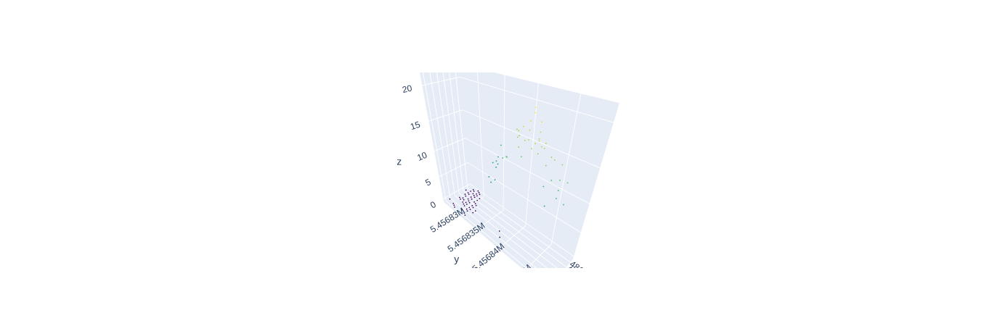

In [156]:
print_points(normalized_points)